# Welcome To The Notebook
In this project, we are going to learn how to analyze Geo-spatial data using python and folium.


## TASK 1
Importing modules

In [1]:
import pandas as pd 
import datetime , calendar
import folium

ModuleNotFoundError: No module named 'folium'

Importing our data

In [12]:
data = pd.read_csv("dataset.csv")
data.head()

,TRIP_ID,CALL_TYPE,TIMESTAMP,TRIP_PATH
0,1372636858620000589,C,1372636858,"[(41.141412, -8.618643), (41.141376, -8.618499..."
1,1372637303620000596,B,1372637303,"[(41.159826, -8.639847), (41.159871, -8.640351..."
2,1372636951620000320,C,1372636951,"[(41.140359, -8.612964), (41.14035, -8.613378)..."
3,1372636854620000520,C,1372636854,"[(41.151951, -8.574678), (41.151942, -8.574705..."
4,1372637091620000337,C,1372637091,"[(41.18049, -8.645994), (41.180517, -8.645949)..."


### Let's talk about the different columns
---
- CALL_TYPE: The way used to demand taxi service
    - 'A' : if this trip was dispatched from the central
    - 'B' : if this trip was demanded directly to a taxi driver on a specific stand 
    - 'C' : other (i.e. a trip demanded on a random street)

- TIMESTAMP: When the trip starts 

- TRIP_PATH: Contains a list of coordinates
    - The first element is the coordinates of the trip's starting point
    - The last element is the coordinates of the trip's end point

## TASK 2
### Data Preprocessing 
Let's extract starting and ending points of each trip <br>

    - Creating two columns START_LOC and END_LOC

In [13]:
#this is a str 
data.TRIP_PATH[0]

'[(41.141412, -8.618643), (41.141376, -8.618499), (41.14251, -8.620326), (41.143815, -8.622153), (41.144373, -8.623953), (41.144778, -8.62668), (41.144697, -8.627373), (41.14521, -8.630226), (41.14692, -8.632746), (41.148225, -8.631738), (41.150385, -8.629938), (41.151213, -8.62911), (41.15124, -8.629128), (41.152203, -8.628786), (41.152374, -8.628687), (41.152518, -8.628759), (41.15268, -8.630838), (41.153022, -8.632323), (41.154489, -8.631144), (41.154507, -8.630829), (41.154516, -8.630829), (41.154498, -8.630829), (41.154489, -8.630838)]'

In [14]:
# using eval to change the data type 
eval(data.TRIP_PATH[0])

[(41.141412, -8.618643),
 (41.141376, -8.618499),
 (41.14251, -8.620326),
 (41.143815, -8.622153),
 (41.144373, -8.623953),
 (41.144778, -8.62668),
 (41.144697, -8.627373),
 (41.14521, -8.630226),
 (41.14692, -8.632746),
 (41.148225, -8.631738),
 (41.150385, -8.629938),
 (41.151213, -8.62911),
 (41.15124, -8.629128),
 (41.152203, -8.628786),
 (41.152374, -8.628687),
 (41.152518, -8.628759),
 (41.15268, -8.630838),
 (41.153022, -8.632323),
 (41.154489, -8.631144),
 (41.154507, -8.630829),
 (41.154516, -8.630829),
 (41.154498, -8.630829),
 (41.154489, -8.630838)]

In [15]:
data.TRIP_PATH = data.TRIP_PATH.apply(eval)
data.head()

,TRIP_ID,CALL_TYPE,TIMESTAMP,TRIP_PATH
0,1372636858620000589,C,1372636858,"[(41.141412, -8.618643), (41.141376, -8.618499..."
1,1372637303620000596,B,1372637303,"[(41.159826, -8.639847), (41.159871, -8.640351..."
2,1372636951620000320,C,1372636951,"[(41.140359, -8.612964), (41.14035, -8.613378)..."
3,1372636854620000520,C,1372636854,"[(41.151951, -8.574678), (41.151942, -8.574705..."
4,1372637091620000337,C,1372637091,"[(41.18049, -8.645994), (41.180517, -8.645949)..."


In [16]:
data.TRIP_PATH[0][0] #FIRST PATH 

(41.141412, -8.618643)

In [17]:
# GETTING START POINT AND END POINT 
extract_starting_point = lambda list_ : list_[0]
extract_ending_point = lambda list_ : list_[-1]
data["START_LOC"] = data.TRIP_PATH.apply(extract_starting_point)
data["END_LOC"] = data.TRIP_PATH.apply(extract_ending_point)

data.head()

,TRIP_ID,CALL_TYPE,TIMESTAMP,TRIP_PATH,START_LOC,END_LOC
0,1372636858620000589,C,1372636858,"[(41.141412, -8.618643), (41.141376, -8.618499...","(41.141412, -8.618643)","(41.154489, -8.630838)"
1,1372637303620000596,B,1372637303,"[(41.159826, -8.639847), (41.159871, -8.640351...","(41.159826, -8.639847)","(41.170671, -8.66574)"
2,1372636951620000320,C,1372636951,"[(41.140359, -8.612964), (41.14035, -8.613378)...","(41.140359, -8.612964)","(41.14053, -8.61597)"
3,1372636854620000520,C,1372636854,"[(41.151951, -8.574678), (41.151942, -8.574705...","(41.151951, -8.574678)","(41.142915, -8.607996)"
4,1372637091620000337,C,1372637091,"[(41.18049, -8.645994), (41.180517, -8.645949)...","(41.18049, -8.645994)","(41.178087, -8.687268)"


Remapping CALL_TYPE column values to the proper values

In [18]:
# UPDATING CALL TYPE COLUMN
CALL_TYPES = {
              "A":"CENTRAL_BASED",
              "B":"STAND_BASED",
              "C":"OTHER"
             }
data.CALL_TYPE = data.CALL_TYPE.map(CALL_TYPES)
data.head()

,TRIP_ID,CALL_TYPE,TIMESTAMP,TRIP_PATH,START_LOC,END_LOC
0,1372636858620000589,OTHER,1372636858,"[(41.141412, -8.618643), (41.141376, -8.618499...","(41.141412, -8.618643)","(41.154489, -8.630838)"
1,1372637303620000596,STAND_BASED,1372637303,"[(41.159826, -8.639847), (41.159871, -8.640351...","(41.159826, -8.639847)","(41.170671, -8.66574)"
2,1372636951620000320,OTHER,1372636951,"[(41.140359, -8.612964), (41.14035, -8.613378)...","(41.140359, -8.612964)","(41.14053, -8.61597)"
3,1372636854620000520,OTHER,1372636854,"[(41.151951, -8.574678), (41.151942, -8.574705...","(41.151951, -8.574678)","(41.142915, -8.607996)"
4,1372637091620000337,OTHER,1372637091,"[(41.18049, -8.645994), (41.180517, -8.645949)...","(41.18049, -8.645994)","(41.178087, -8.687268)"


### Data Analysis 
Let's answer to some analytical questions using our data 
 
 

### Question 1 - What are the most common ways to get a taxi in Porto?

In [23]:
q1_data = data.CALL_TYPE.value_counts(sort=False)
q1_data

CENTRAL_BASED    2337
STAND_BASED      5164
OTHER            2499
Name: CALL_TYPE, dtype: int64

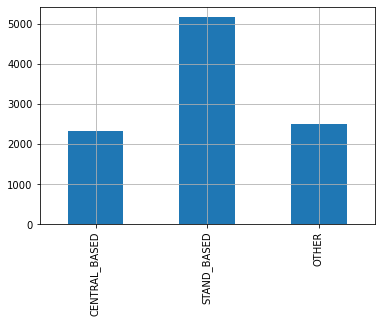

In [24]:
q1_data.plot.bar(grid=True)

# TASK 3

### Question 2 - Which regions of the city are the best pick up points?
    To answer to this question we can use a dotmap.
    A dotmap is a scatter plot which is put on a map to represent a geographic data distribution.
    And then by looking at the different clusters of the points on the map we can get the answer.

Let's load our map 

In [25]:
Map = folium.Map()
Map

In [26]:
# Porto coordinates (41.15,-8.62)
Map = folium.Map(location = [41.15,-8.62], zoom_start = 14)
Map

In [28]:
#ADDING FIRST START POINT TO THE MAP 
Map = folium.Map(location = [41.15,-8.62], zoom_start = 14)

point = data.START_LOC.iloc[0]
folium.CircleMarker(location = point , color= "red", radius = 1, weight = 2).add_to(Map)
Map

In [29]:
#ADDING ALL FIRST START POINTS TO THE MAP USING fOR LOOP
#by doing this we could have a good representation of different clusters of data points in Porto 
# Answer: Each cluster represent a popular region to get a taxi
Map = folium.Map(location = [41.15,-8.62], zoom_start = 14)

for point in data.START_LOC:
    folium.CircleMarker(location = point , color= "red", radius = 1, weight = 2).add_to(Map)
Map

### Question 3 - Which regions of the city are the best pick up points for stand-based trips?
    To answer to this question we create a dotmap with different Marker clusters, each cluster corresponds to a specific
    CALL_TYPE.

Let's check our data again 

In [30]:
data.head()

,TRIP_ID,CALL_TYPE,TIMESTAMP,TRIP_PATH,START_LOC,END_LOC
0,1372636858620000589,OTHER,1372636858,"[(41.141412, -8.618643), (41.141376, -8.618499...","(41.141412, -8.618643)","(41.154489, -8.630838)"
1,1372637303620000596,STAND_BASED,1372637303,"[(41.159826, -8.639847), (41.159871, -8.640351...","(41.159826, -8.639847)","(41.170671, -8.66574)"
2,1372636951620000320,OTHER,1372636951,"[(41.140359, -8.612964), (41.14035, -8.613378)...","(41.140359, -8.612964)","(41.14053, -8.61597)"
3,1372636854620000520,OTHER,1372636854,"[(41.151951, -8.574678), (41.151942, -8.574705...","(41.151951, -8.574678)","(41.142915, -8.607996)"
4,1372637091620000337,OTHER,1372637091,"[(41.18049, -8.645994), (41.180517, -8.645949)...","(41.18049, -8.645994)","(41.178087, -8.687268)"


Let's create our map

In [33]:
# Answer = clusters of color red represent the popular pick up regions for stand based trips
q3_Map = folium.Map(location = [41.15, -8.62], zoom_start = 14)

colors = {"OTHER" : "green",
         "STAND_BASED" : "red",
         "CENTRAL_BASED" : "blue"}

q3_data = data[["CALL_TYPE", "START_LOC"]]

for index, row in q3_data.iterrows():
    color = colors[row["CALL_TYPE"]]
    location = row["START_LOC"]
    folium.CircleMarker(location , color = color, radius = 1, weight = 2).add_to(q3_Map)

q3_Map

## TASK 4
### Question 4 - Which regions of the city are the most common destinations on Mondays? 
    To answer to this question we need to use the TIMESTAMP column to extract the day each trip took place. 

In [34]:
data.TIMESTAMP.iloc[0]

1372636858

In [35]:
#finding the index of each day of the week 
datetime.datetime.fromtimestamp(data.TIMESTAMP.iloc[0]).weekday()

0

In [38]:
day_names = list(calendar.day_name)
day_names

['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']

In [40]:
#creating a list of weekdays and then adding another column in the data
get_day = lambda timestamp : day_names[datetime.datetime.fromtimestamp(timestamp).weekday()]
data["WEEK_DAY"] = data.TIMESTAMP.apply(get_day)
data.head()

,TRIP_ID,CALL_TYPE,TIMESTAMP,TRIP_PATH,START_LOC,END_LOC,WEEK_DAY
0,1372636858620000589,OTHER,1372636858,"[(41.141412, -8.618643), (41.141376, -8.618499...","(41.141412, -8.618643)","(41.154489, -8.630838)",Monday
1,1372637303620000596,STAND_BASED,1372637303,"[(41.159826, -8.639847), (41.159871, -8.640351...","(41.159826, -8.639847)","(41.170671, -8.66574)",Monday
2,1372636951620000320,OTHER,1372636951,"[(41.140359, -8.612964), (41.14035, -8.613378)...","(41.140359, -8.612964)","(41.14053, -8.61597)",Monday
3,1372636854620000520,OTHER,1372636854,"[(41.151951, -8.574678), (41.151942, -8.574705...","(41.151951, -8.574678)","(41.142915, -8.607996)",Monday
4,1372637091620000337,OTHER,1372637091,"[(41.18049, -8.645994), (41.180517, -8.645949)...","(41.18049, -8.645994)","(41.178087, -8.687268)",Monday


Let's get all the trips on Mondays 

In [43]:
q4_data = data[data.WEEK_DAY == "Monday"]
q4_data.head()

,TRIP_ID,CALL_TYPE,TIMESTAMP,TRIP_PATH,START_LOC,END_LOC,WEEK_DAY
0,1372636858620000589,OTHER,1372636858,"[(41.141412, -8.618643), (41.141376, -8.618499...","(41.141412, -8.618643)","(41.154489, -8.630838)",Monday
1,1372637303620000596,STAND_BASED,1372637303,"[(41.159826, -8.639847), (41.159871, -8.640351...","(41.159826, -8.639847)","(41.170671, -8.66574)",Monday
2,1372636951620000320,OTHER,1372636951,"[(41.140359, -8.612964), (41.14035, -8.613378)...","(41.140359, -8.612964)","(41.14053, -8.61597)",Monday
3,1372636854620000520,OTHER,1372636854,"[(41.151951, -8.574678), (41.151942, -8.574705...","(41.151951, -8.574678)","(41.142915, -8.607996)",Monday
4,1372637091620000337,OTHER,1372637091,"[(41.18049, -8.645994), (41.180517, -8.645949)...","(41.18049, -8.645994)","(41.178087, -8.687268)",Monday


Now Let's visualize the data on the map

In [45]:
# Each cluster represents popular destinations on MONDAY
q4_map = folium.Map(location = [41.15, -8.62], zoom_start= 14)

for point in q4_data.END_LOC:
    folium.CircleMarker(location = point, color = "blue", radius= 1, weight=2).add_to(q4_map)
q4_map


### Question 5 - What are the most common start and end points on Monday Mornings (from 6 am to 9 am)?
    To answer to this question we need to extract the hour information for each of the trips. 

Let's extract the hour column from TIMESTAMP column 

In [47]:
extract_hour = lambda timestamp : datetime.datetime.fromtimestamp(timestamp).hour

data["HOUR"] = data.TIMESTAMP.apply(extract_hour)
data.head()

,TRIP_ID,CALL_TYPE,TIMESTAMP,TRIP_PATH,START_LOC,END_LOC,WEEK_DAY,HOUR
0,1372636858620000589,OTHER,1372636858,"[(41.141412, -8.618643), (41.141376, -8.618499...","(41.141412, -8.618643)","(41.154489, -8.630838)",Monday,0
1,1372637303620000596,STAND_BASED,1372637303,"[(41.159826, -8.639847), (41.159871, -8.640351...","(41.159826, -8.639847)","(41.170671, -8.66574)",Monday,0
2,1372636951620000320,OTHER,1372636951,"[(41.140359, -8.612964), (41.14035, -8.613378)...","(41.140359, -8.612964)","(41.14053, -8.61597)",Monday,0
3,1372636854620000520,OTHER,1372636854,"[(41.151951, -8.574678), (41.151942, -8.574705...","(41.151951, -8.574678)","(41.142915, -8.607996)",Monday,0
4,1372637091620000337,OTHER,1372637091,"[(41.18049, -8.645994), (41.180517, -8.645949)...","(41.18049, -8.645994)","(41.178087, -8.687268)",Monday,0


Let's get the trips which took place between 6 am to 9 am on Mondays

In [51]:
q5_data = data[(data.WEEK_DAY == "Monday") & (data.HOUR > 6) & (data.HOUR < 9)]
q5_data.head()

,TRIP_ID,CALL_TYPE,TIMESTAMP,TRIP_PATH,START_LOC,END_LOC,WEEK_DAY,HOUR
443,1372662532620000051,STAND_BASED,1372662532,"[(41.140692, -8.615601), (41.140854, -8.615349...","(41.140692, -8.615601)","(41.147145, -8.615223)",Monday,7
450,1372662153620000351,OTHER,1372662153,"[(41.236965, -8.670015), (41.235633, -8.669727...","(41.236965, -8.670015)","(41.16888, -8.590365)",Monday,7
454,1372663182620000247,CENTRAL_BASED,1372663182,"[(41.157639, -8.593767), (41.156982, -8.594208...","(41.157639, -8.593767)","(41.147154, -8.617599)",Monday,7
464,1372662071620000662,OTHER,1372662071,"[(41.156559, -8.641611), (41.156541, -8.641431...","(41.156559, -8.641611)","(41.155875, -8.620776)",Monday,7
465,1372662631620000621,CENTRAL_BASED,1372662631,"[(41.159079, -8.611902), (41.159061, -8.611911...","(41.159079, -8.611902)","(41.149764, -8.619696)",Monday,7


Now let's visualize this data

In [54]:
#Answer : Red dots represent most popular START points and blue the most popular END points
q5_map = folium.Map(location = [41.15, -8.62], zoom_start = 14)
put_start_loc = lambda loc : folium.CircleMarker(loc, color = "red", radius = 1, weight = 2).add_to(q5_map)
put_end_loc = lambda loc : folium.CircleMarker(loc, color= "blue", radius = 1, weight = 2).add_to(q5_map)

q5_data.START_LOC.apply(put_start_loc)
q5_data.END_LOC.apply(put_end_loc)

q5_map

## TASK 5
### Question 6 - Find out the rush hour in Porto

In [57]:
data.HOUR.value_counts()

9     724
8     684
7     678
13    616
14    602
10    569
15    558
16    544
12    519
11    511
17    490
18    390
6     368
19    331
20    293
3     274
0     264
21    258
5     252
4     243
22    227
2     217
23    198
1     190
Name: HOUR, dtype: int64

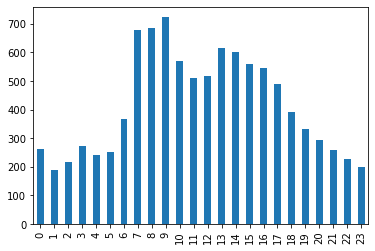

In [59]:
data.HOUR.value_counts().sort_index().plot.bar()

### Question 7 - Which streets has the more traffic during the rush hour
    To answer to this question we need to use TRIP_PATH column to visualize each path as a line on the map.
    Firstly, let's filter out the needed data. 

In [60]:
q7_data = data[data.HOUR==9]
q7_data.head()

,TRIP_ID,CALL_TYPE,TIMESTAMP,TRIP_PATH,START_LOC,END_LOC,WEEK_DAY,HOUR
937,1372669784620000455,OTHER,1372669784,"[(41.166252, -8.607528), (41.165748, -8.608149...","(41.166252, -8.607528)","(41.164875, -8.608536)",Monday,9
947,1372669436620000285,STAND_BASED,1372669436,"[(41.145606, -8.610813), (41.145777, -8.610813...","(41.145606, -8.610813)","(41.149242, -8.627157)",Monday,9
956,1372669271620000653,STAND_BASED,1372669271,"[(41.15772, -8.628399)]","(41.15772, -8.628399)","(41.15772, -8.628399)",Monday,9
965,1372669911620000455,OTHER,1372669911,"[(41.164857, -8.608527), (41.16474, -8.608509)...","(41.164857, -8.608527)","(41.155362, -8.610237)",Monday,9
972,1372669864620000050,CENTRAL_BASED,1372669864,"[(41.155866, -8.643798), (41.156811, -8.643591...","(41.155866, -8.643798)","(41.148882, -8.648964)",Monday,9


In [70]:
# Second trip 
coords = q7_data.TRIP_PATH.iloc[1]

q7_map = folium.Map(location = [41.15, -8.62], zoom_start=13)
folium.PolyLine(coords,color= "red", opacity = 0.5, weight = 2).add_to(q7_map)

q7_map

In [74]:
# Doing a for loop for every trip. Also opacity is change to 0.05 for better visualization
#to distinguish the most used streets during rush hour 
q7_map = folium.Map(location = [41.15, -8.62], zoom_start=14)
for coords in q7_data.TRIP_PATH:
    folium.PolyLine(coords,color= "red", opacity = 0.05, weight = 2).add_to(q7_map)

q7_map